<a href="https://colab.research.google.com/github/everythingapplejj/Research-Graph-Embeddings-/blob/JJ/mcmc_samples_with_Data_cleaning_beta_8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

ERROR: Operation cancelled by user
Traceback (most recent call last):
  File "/usr/local/bin/pip3", line 5, in <module>
    from pip._internal.cli.main import main
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/main.py", line 10, in <module>
    from pip._internal.cli.autocompletion import autocomplete
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/autocompletion.py", line 10, in <module>
    from pip._internal.cli.main_parser import create_main_parser
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/main_parser.py", line 9, in <module>
    from pip._internal.build_env import get_runnable_pip
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/build_env.py", line 15, in <module>
    from pip._vendor.packaging.requirements import Requirement
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/packaging/requirements.py", line 23, in <module>
    from .markers import MARKER_EXPR, Marker
  File "/usr/local/lib/python3

In [2]:
# We assume that PyTorch is already installed
import torch
torchversion = torch.__version__

# Install PyTorch Scatter, PyTorch Sparse, and PyTorch Geometric
!pip install -q torch-scatter -f https://data.pyg.org/whl/torch-{torchversion}.html
!pip install -q torch-sparse -f https://data.pyg.org/whl/torch-{torchversion}.html
!pip install -q git+https://github.com/pyg-team/pytorch_geometric.git

# Visualization
import networkx as nx
import matplotlib.pyplot as plt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 17.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
# this program is with the pre_data cleaning :)
# Duplicated nodes from the node_list and adj_matrix will be removed
# This google colab includes the methodology for graph embeddings. And removing the subgraphs.

In [3]:
accuracy_collector = []

In [ ]:
print("Welcome to Graph Embeddings!")

Welcome to Graph Embeddings!


In [4]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
#testing visualization
#Implementation by Jiwoong Jung
import torch

#placeholder values:

# Print information about the dataset


# Visualization
import networkx as nx
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 300
plt.rcParams.update({'font.size': 24})
from torch_geometric.utils import to_networkx
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
"""
Created on Wed Aug 23 12:22:38 2023

@author: vishalr
"""

# we can use the node labels for the first set of the x values
# figure out ways to include diff files for the y_features (1st priority)
# for now, do the y label first,
# later consider the edge features and node features

import pandas as pd
import pickle
import numpy as np


#change this to the folder where you store your data
data_dir = "/content/sample_data/"

#each of the two data frames below have 20,000 rows, each corresponding to one sample from the original graph
#each sample consists of 21 nodes; node_labels contains the names of these 21 nodes of the form Vxyz
#each node is a DNA fragment of length 500 bases; so Vxyz coveres region [500*xyz, 500*xyz+500)
#adjacency_matrix has the flattended adjacecny matrix for each of these 20,000 samples
#so each row is of dimension 21*21 = 441


#node_labels = np.load(data_dir+'df_chr2R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot_sample_node_matrix.npy')

#adjacency_matrix = np.load(data_dir+'df_chr2R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot.npy')

worklist_node_labels = []
worklist_adjacency_matrix = []

#importing the rest of the files
# 2L = 0; 2R = 1; 3L = 2, 3R = 3

node_labels_2L = np.load(data_dir+'df_chr2L_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot_sample_node_matrix.npy')
adjacency_matrix_2L = np.load(data_dir+'df_chr2L_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot.npy')

worklist_node_labels.append(node_labels_2L)
worklist_adjacency_matrix.append(adjacency_matrix_2L)

node_labels_2R = np.load(data_dir+'df_chr2R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot_sample_node_matrix.npy')
adjacency_matrix_2R = np.load(data_dir+'df_chr2R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot.npy')

worklist_node_labels.append(node_labels_2R)
worklist_adjacency_matrix.append(adjacency_matrix_2R)

node_labels_3L = np.load(data_dir+'df_chr3L_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot_sample_node_matrix.npy')
adjacency_matrix_3L = np.load(data_dir+'df_chr3L_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot.npy')

worklist_node_labels.append(node_labels_3L)
worklist_adjacency_matrix.append(adjacency_matrix_3L)

node_labels_3R = np.load(data_dir+'df_chr3R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot_sample_node_matrix.npy')
adjacency_matrix_3R = np.load(data_dir+'df_chr3R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot.npy')


worklist_node_labels.append(node_labels_3R)
worklist_adjacency_matrix.append(adjacency_matrix_3R)

In [12]:
import numpy as np
print(worklist_node_labels)

[array([[ 5997, 19835,   969, ...,  4455, 27017, 27025],
       [41207, 22040, 41207, ...,   135,   186,   153],
       [13615, 16412, 16377, ..., 41754, 41780, 41767],
       ...,
       [39599,  9995, 38842, ..., 33868, 20856, 14348],
       [39954,  9995, 10131, ...,  2117,  2259,  2251],
       [32509, 19793, 19783, ...,  7313, 42107, 41499]]), array([[34307, 23565,  5042, ...,  5114, 12844, 12993],
       [36450, 36179, 36450, ..., 22359, 28058, 30979],
       [36450, 36179, 33947, ...,  9673, 20209, 12537],
       ...,
       [ 7427, 39513, 19626, ..., 25109, 25119, 27062],
       [33656, 20125, 24230, ..., 28043, 29127, 29091],
       [ 8127, 38554,  7700, ..., 24445, 25489,  3057]]), array([[41331,  1284,  1255, ..., 32082, 18737, 18660],
       [ 1284,  1349,  1363, ...,  3939,  5692, 17395],
       [24386,  5147, 32020, ..., 28096,  6446, 41308],
       ...,
       [ 3375, 19321,  1419, ..., 17371, 28421, 17371],
       [44210,  1306,  3592, ..., 11490,  1774, 35930],
       

In [5]:
print(worklist_adjacency_matrix)

[array([[ 0.,  1.,  1., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       ...,
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.]]), array([[ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  1., ...,  1.,  0., -1.],
       ...,
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  1., ...,  1.,  0., -1.]]), array([[ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       ...,
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.]]), array([[ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       ...,
       [ 0.,  1.,  0.

In [13]:
for i in range(0,len(worklist_adjacency_matrix)):
  worklist_adjacency_matrix[i] = worklist_adjacency_matrix[i][:,:-1]
#adjacency_matrix = adjacency_matrix[:,:-1]

In [14]:
print(worklist_adjacency_matrix)

[array([[0., 1., 1., ..., 0., 1., 0.],
       [0., 1., 0., ..., 1., 1., 0.],
       [0., 1., 0., ..., 1., 1., 0.],
       ...,
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.]]), array([[0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 1., ..., 0., 1., 0.],
       ...,
       [0., 1., 0., ..., 1., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 1., ..., 0., 1., 0.]]), array([[0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       ...,
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.]]), array([[0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       ...,
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 1., 1., 0.]])]


In [15]:
# proceeding with data cleaning:
import numpy as np
def remove_duplicates(node_labels, adj_matrix):
  sample_nodes = node_labels
  sample_adj_matrix = adj_matrix
  i = 0
  j = i + 1
  while(i < len(sample_nodes) - 1):
    if(sample_nodes[i] == sample_nodes[j]):
      sample_nodes = np.delete(sample_nodes,j)
      sample_adj_matrix = np.delete(np.delete(sample_adj_matrix, j, 0), j, 1)
      if(j >= len(sample_nodes)):
        i = i + 1
        j = i + 1
      continue
    else:
      j = j + 1
      if(j >= len(sample_nodes)):
        i = i + 1
        j = i + 1
  #return sample_nodes, sample_adj_matrix
  return node_labels, adj_matrix

In [ ]:
#next

In [16]:
import torch
from torch_geometric.data import Data, InMemoryDataset
from torch_geometric.utils import from_scipy_sparse_matrix
import scipy.sparse as sp
import numpy as np
import random

class MyCustomDataset(InMemoryDataset):
    def __init__(self, data_list, transform=None, pre_transform=None):
        self.data_list = data_list
        super(MyCustomDataset, self).__init__(None, transform, pre_transform)
        self.data, self.slices = self.collate(data_list)

    @property
    def raw_file_names(self):
        return []

    @property
    def processed_file_names(self):
        return []

    def download(self):
        pass

    def process(self):
        pass

    def len(self):
        return len(self.data_list)

    def get(self, idx):
        return self.data_list[idx]

# Remove duplicate nodes
def remove_duplicates(node_labels, adj_matrix):
    unique_nodes = []
    unique_indices = []

    for idx, node in enumerate(node_labels):
        if node not in unique_nodes:
            unique_nodes.append(node)
            unique_indices.append(idx)

    unique_nodes = np.array(unique_nodes)
    sample_adj_matrix = adj_matrix[np.ix_(unique_indices, unique_indices)]

    return unique_nodes, sample_adj_matrix

# Create the dataset
dataset = []
label_number = 0

# Iterate through each adjacency matrix and its corresponding node labels
for adjacency_matrix, node_labels in zip(worklist_adjacency_matrix, worklist_node_labels):
    y = np.array([label_number])
    y = torch.from_numpy(y).type(torch.LongTensor)

    # Randomly select 10% of the data for processing
    num_samples = int(adjacency_matrix.shape[0] * 0.1)
    indices = random.sample(range(adjacency_matrix.shape[0]), num_samples)
    adj_matrix_sampled = adjacency_matrix[indices]
    node_labels_sampled = node_labels[indices]

    for graph, node_label in zip(adj_matrix_sampled, node_labels_sampled):
        sample_graph = graph.reshape(21, 21)
        sample_node, sample_graph = remove_duplicates(node_label, sample_graph)

        new_sample_node = np.array([])
        new_sample_graph = np.zeros((sample_graph.shape[0] * 2, sample_graph.shape[1] * 2))

        random_values = np.random.randint(low=np.min(sample_node), high=np.max(sample_node) + 1, size=sample_node.shape[0])
        counter = 0
        for i in range(0, sample_node.shape[0]):
            new_sample_node = np.append(new_sample_node, random_values[i])
            new_sample_node = np.append(new_sample_node, sample_node[counter])
            counter += 1

        next_counter = 0
        next_adj = sample_graph.flatten()
        for i in range(0, new_sample_graph.shape[0]):
            for j in range(0, new_sample_graph.shape[1]):
                if i % 2 == 0:
                    continue
                else:
                    if j % 2 != 0:
                        new_sample_graph[i][j] = next_adj[next_counter]
                        next_counter += 1

        # Convert to PyTorch tensors
        sample_node_labels = torch.from_numpy(new_sample_node).type(torch.LongTensor).view(-1, 1)
        x = sample_node_labels
        adj_matrix = sp.coo_matrix(new_sample_graph)
        edge_index, edge_attr = from_scipy_sparse_matrix(adj_matrix)

        data = Data(x=x, edge_index=edge_index, y=y)
        dataset.append(data)

    label_number += 1

dataset = MyCustomDataset(dataset).shuffle()

# Example: Accessing the first graph in the custom dataset
print(dataset[0])
print("Number of Nodes (x):")
print(dataset[0].x)
# Node features are currently empty
print("Edge index:")
print(dataset[0].edge_index)
print("Labels (y):")
print(dataset.y)
print(len(dataset))


Processing...
Done!


Data(x=[38, 1], edge_index=[2, 42], y=[1])
Number of Nodes (x):
tensor([[29102],
        [ 1129],
        [35009],
        [ 6145],
        [30016],
        [ 8719],
        [33532],
        [21238],
        [34674],
        [20440],
        [38319],
        [16874],
        [23004],
        [22375],
        [29403],
        [16882],
        [33651],
        [17098],
        [31599],
        [ 4381],
        [21882],
        [24541],
        [36457],
        [33252],
        [15110],
        [39576],
        [ 8820],
        [35328],
        [21334],
        [ 6386],
        [32345],
        [ 1280],
        [35787],
        [14667],
        [14050],
        [ 4979],
        [19682],
        [  422]])
Edge index:
tensor([[ 1,  3,  3,  5,  5,  5,  7,  7,  9,  9,  9, 11, 11, 11, 13, 13, 15, 15,
         15, 17, 17, 17, 17, 19, 19, 21, 21, 23, 23, 25, 25, 27, 27, 29, 29, 31,
         31, 33, 33, 35, 35, 37],
        [ 3,  1,  5,  3,  7,  9,  5,  9,  5,  7, 11,  9, 13, 15, 11, 15, 11, 13,


In [21]:
print(f'Sample Edge_Attr: {edge_placeholder}') #every Edge_Attr is 1 for now.?

Sample Edge_Attr: 0


In [22]:
print(dataset[20000])
print(dataset[0])
print(dataset[10000])
print(dataset[70000])
print(dataset[len(dataset) - 1])

IndexError: list index out of range

In [23]:
#testing the visualization of the graph

def graph_visuals(data_input):
  G = to_networkx(data_input, to_undirected=True)

# 3D spring layout
  pos = nx.spring_layout(G, dim=3, seed=0)

# Extract node and edge positions from the layout
  node_xyz = np.array([pos[v] for v in sorted(G)])
  edge_xyz = np.array([(pos[u], pos[v]) for u, v in G.edges()])

# Create the 3D figure
  fig = plt.figure(figsize=(16,16))
  ax = fig.add_subplot(111, projection="3d")

# Suppress tick labels
  for dim in (ax.xaxis, ax.yaxis, ax.zaxis):
      dim.set_ticks([])

# Plot the nodes - alpha is scaled by "depth" automatically
  ax.scatter(*node_xyz.T, s=500, c="#0A047A")

# Plot the edges
  for vizedge in edge_xyz:
      ax.plot(*vizedge.T, color="tab:gray")

# fig.tight_layout()
  plt.show()



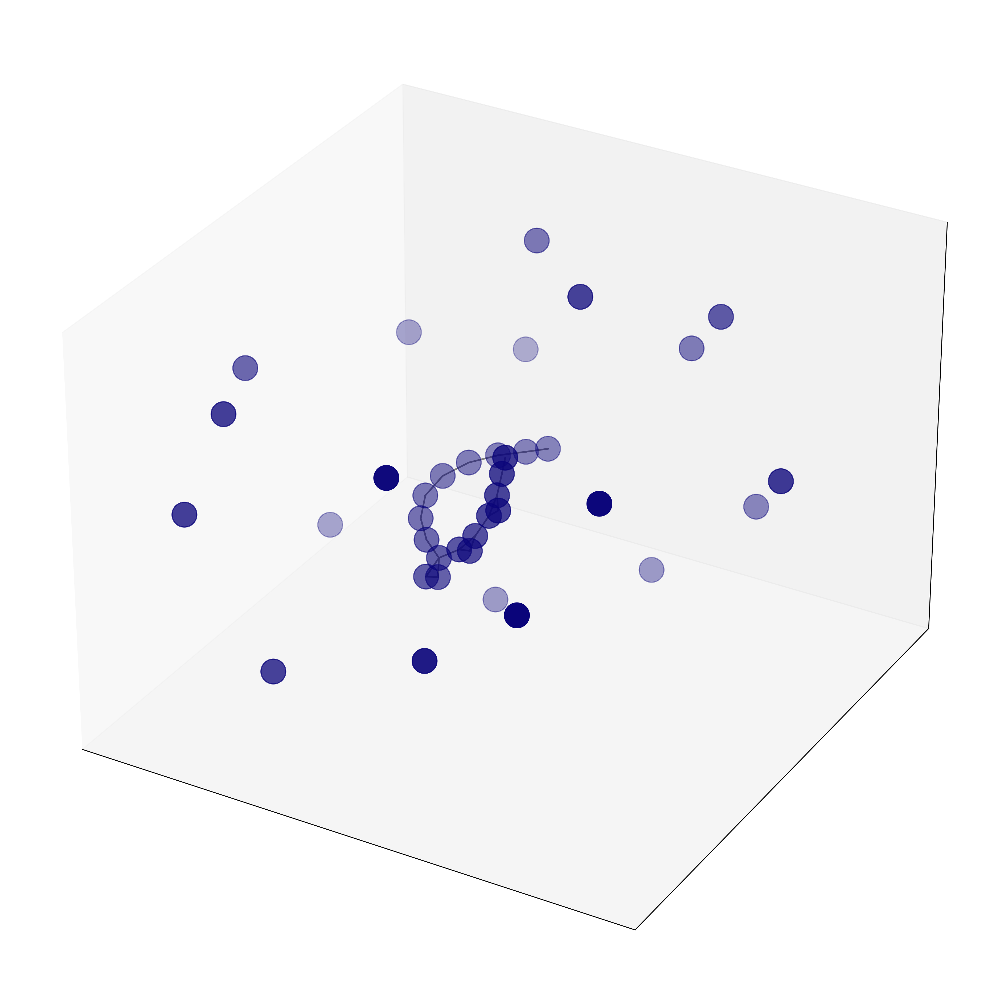

IndexError: list index out of range

In [24]:
graph_visuals(dataset[0])
graph_visuals(dataset[12312])
graph_visuals(dataset[40000])
graph_visuals(dataset[60023])
graph_visuals(dataset[len(dataset) - 1])

In [26]:
#embeddings testing

import torch
import torch.nn.functional as F
from torch.nn import Sequential, Linear, ReLU, BatchNorm1d
from torch_geometric.nn import GINConv, global_add_pool
import matplotlib.pyplot as plt

class GIN(torch.nn.Module):
    """GIN"""
    def __init__(self, dim_h):
        super(GIN, self).__init__()
        self.conv1 = GINConv(
            Sequential(Linear(dataset.num_node_features, dim_h),
                       BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.conv2 = GINConv(
            Sequential(Linear(dim_h, dim_h), BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.conv3 = GINConv(
            Sequential(Linear(dim_h, dim_h), BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.lin1 = Linear(dim_h*3, dim_h*3)
        self.lin2 = Linear(dim_h*3, dataset.num_classes)

    def forward(self, x, edge_index, batch):
        # Node embeddings
        h1 = self.conv1(x, edge_index)
        h2 = self.conv2(h1, edge_index)
        h3 = self.conv3(h2, edge_index)

        # Graph-level readout
        h1 = global_add_pool(h1, batch)
        h2 = global_add_pool(h2, batch)
        h3 = global_add_pool(h3, batch)

        # Concatenate graph embeddings
        h = torch.cat((h1, h2, h3), dim=1)

        # Classifier
        h = self.lin1(h)
        h = h.relu()
        h = F.dropout(h, p=0.5, training=self.training)
        h = self.lin2(h)

        return h, F.log_softmax(h, dim=1)

#gcn = GCN(dim_h=32)
gin = GIN(dim_h=32)

In [ ]:
# training for embedding

In [25]:
from torch_geometric.loader import DataLoader
# Create training, validation, and test sets
print(dataset[10])
train_dataset = dataset[:int(len(dataset)*0.8)]
val_dataset   = dataset[int(len(dataset)*0.8):int(len(dataset)*0.9)]
test_dataset  = dataset[int(len(dataset)*0.9):]

print(f'Training set   = {len(train_dataset)} graphs')
print(f'Validation set = {len(val_dataset)} graphs')
print(f'Test set       = {len(test_dataset)} graphs')

# Create mini-batches
train_loader = DataLoader(train_dataset, batch_size = 64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

print('\nTrain loader:')
for i, subgraph in enumerate(train_loader):
    print(f' - Subgraph {i}: {subgraph}')

print('\nValidation loader:')
for i, subgraph in enumerate(val_loader):
    print(f' - Subgraph {i}: {subgraph}')

print('\nTest loader:')
for i, subgraph in enumerate(test_loader):
    print(f' - Subgraph {i}: {subgraph}')

Data(x=[40, 1], edge_index=[2, 42], y=[1])
Training set   = 6400 graphs
Validation set = 800 graphs
Test set       = 800 graphs

Train loader:
 - Subgraph 0: DataBatch(x=[2220, 1], edge_index=[2, 2496], y=[64], batch=[2220], ptr=[65])
 - Subgraph 1: DataBatch(x=[2158, 1], edge_index=[2, 2344], y=[64], batch=[2158], ptr=[65])
 - Subgraph 2: DataBatch(x=[2154, 1], edge_index=[2, 2408], y=[64], batch=[2154], ptr=[65])
 - Subgraph 3: DataBatch(x=[2224, 1], edge_index=[2, 2408], y=[64], batch=[2224], ptr=[65])
 - Subgraph 4: DataBatch(x=[2204, 1], edge_index=[2, 2448], y=[64], batch=[2204], ptr=[65])
 - Subgraph 5: DataBatch(x=[2150, 1], edge_index=[2, 2376], y=[64], batch=[2150], ptr=[65])
 - Subgraph 6: DataBatch(x=[2194, 1], edge_index=[2, 2406], y=[64], batch=[2194], ptr=[65])
 - Subgraph 7: DataBatch(x=[2210, 1], edge_index=[2, 2430], y=[64], batch=[2210], ptr=[65])
 - Subgraph 8: DataBatch(x=[2210, 1], edge_index=[2, 2422], y=[64], batch=[2210], ptr=[65])
 - Subgraph 9: DataBatch(x=[2

In [32]:
def train(model, loader):
    criterion = torch.nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(),
                                      lr=0.01,
                                      weight_decay=0.01)
    epochs = 10

    model.train()
    for epoch in range(epochs+1):
        #print(epoch)
        total_loss = 0
        acc = 0
        val_loss = 0
        val_acc = 0

        # Train on batches
        for data in loader:
          optimizer.zero_grad()
          _, out = model(data.x, data.edge_index, data.batch)
          loss = criterion(out, data.y)
          total_loss += loss / len(loader)
          acc += accuracy(out.argmax(dim=1), data.y) / len(loader)
          loss.backward()
          optimizer.step()

          # Validation
          val_loss, val_acc = test(model, val_loader)

          # print per epoch to see if the accuracy goes up!
        print(f'Epoch {epoch:>0} | Train Loss: {total_loss:.2f} '
            f'| Train Acc: {acc*100:>5.2f}% '
            f'| Val Loss: {val_loss:.2f} '
            f'| Val Acc: {val_acc*100:.2f}%')


    test_loss, test_acc = test(model, test_loader)
    print(f'Test Loss: {test_loss:.2f} | Test Acc: {test_acc*100:.2f}%')

    return model

@torch.no_grad()
def test(model, loader):
    criterion = torch.nn.CrossEntropyLoss()
    model.eval()
    loss = 0
    acc = 0

    for data in loader:
        _, out = model(data.x, data.edge_index, data.batch)
        loss += criterion(out, data.y) / len(loader)
        acc += accuracy(out.argmax(dim=1), data.y) / len(loader)

    return loss, acc

def accuracy(pred_y, y):
    """Calculate accuracy."""
    return ((pred_y == y).sum() / len(y)).item()

#gcn = train(gcn, train_loader)
gin = train(gin, train_loader)

Epoch 0 | Train Loss: 1.06 | Train Acc: 56.55% | Val Loss: 0.89 | Val Acc: 56.25%
Epoch 1 | Train Loss: 0.93 | Train Acc: 57.42% | Val Loss: 0.92 | Val Acc: 55.17%
Epoch 2 | Train Loss: 0.91 | Train Acc: 58.12% | Val Loss: 0.91 | Val Acc: 59.25%
Epoch 3 | Train Loss: 0.91 | Train Acc: 57.95% | Val Loss: 0.89 | Val Acc: 57.69%
Epoch 4 | Train Loss: 0.91 | Train Acc: 58.19% | Val Loss: 0.91 | Val Acc: 56.49%
Epoch 5 | Train Loss: 0.91 | Train Acc: 58.08% | Val Loss: 0.88 | Val Acc: 58.05%
Epoch 6 | Train Loss: 0.90 | Train Acc: 59.33% | Val Loss: 0.93 | Val Acc: 56.73%
Epoch 7 | Train Loss: 0.90 | Train Acc: 58.41% | Val Loss: 0.88 | Val Acc: 59.74%
Epoch 8 | Train Loss: 0.91 | Train Acc: 58.06% | Val Loss: 0.92 | Val Acc: 57.57%
Epoch 9 | Train Loss: 0.89 | Train Acc: 58.08% | Val Loss: 0.90 | Val Acc: 57.81%
Epoch 10 | Train Loss: 0.89 | Train Acc: 59.30% | Val Loss: 0.91 | Val Acc: 58.05%
Test Loss: 0.99 | Test Acc: 53.49%


In [28]:
tester_reference = np.zeros((21,21))
for chromosome in worklist_adjacency_matrix:
  for graphs in chromosome:
    graphs = graphs.reshape((21,21))
    tester_reference = tester_reference + graphs

tester_reference = tester_reference/80000

for i in range(0, tester_reference.shape[0]):
  for j in range(0, tester_reference.shape[1]):
    if(tester_reference[i][j] > 0.5):
      tester_reference[i][j] = 1
    else:
      tester_reference[i][j] = 0

print(tester_reference)

[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0.

In [29]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import torch
import scipy.sparse as sp
from torch_geometric.utils import from_scipy_sparse_matrix
from torch_geometric.data import Data

# Assuming embeddings_out and embeddings_out_reference are numpy arrays
torch.manual_seed(42)
np.random.seed(42)

model = GIN(dim_h=32)  # Replace with your model initialization
model.eval()

threshold_val = 30000

# Initialize lists to store embeddings and labels
embeddings_list = []
labels_list = []
distance_list = []
dis_label_list = []
selected = []

for data in dataset:
    new_x = data.x
    new_y = data.y

    # Create a reference graph with edges between consecutive nodes
    reference_graph = np.zeros((len(data.x), len(data.x)))
    #print(reference_graph.shape)
    #print(tester_reference.shape)
    '''
    for i in range(0,reference_graph.shape[0]):
      for j in range(0, reference_graph.shape[1]):
        if(tester_reference[i][j] == 1):
          reference_graph[i][j] = 1
        else:
          reference_graph[i][j] = 0
    '''
    for i in range(reference_graph.shape[0] - 1):
        reference_graph[i][i + 1] = 1
        reference_graph[i + 1][i] = 1

    reference_adj = sp.coo_matrix(reference_graph)
    edge_index, edge_attr = from_scipy_sparse_matrix(reference_adj)
    data_reference = Data(x=new_x, edge_index=edge_index, y=new_y)

    with torch.no_grad():
        # Get embeddings from the model
        embedding_out, _ = model(data.x, data.edge_index, data.batch)
        embedding_out_reference, _ = model(data_reference.x, data_reference.edge_index, data.batch)
    # Convert embeddings to numpy arrays and detach from gradient computation
    out_tensor = embedding_out.detach().numpy()
    reference_out_tensor = embedding_out_reference.detach().numpy()
    #print(embedding_out.argmax(dim = 1))
    # Append embeddings and labels to lists
    embeddings_list.append(out_tensor)
    embeddings_list.append(reference_out_tensor)
    labels_list.append(data.y.numpy())
    labels_list.append(data_reference.y.numpy())
    # Calculate Euclidean distance and select based on threshold
    e_dis = np.linalg.norm(out_tensor - reference_out_tensor)
    if e_dis >= threshold_val:
        selected.append(data)
        sampling = np.array(out_tensor)
        distance_list.append(sampling)
        dis_label_list.append(data.y.numpy())


# Convert lists to numpy arrays for plotting
measure = np.array(distance_list)
embeddings = np.array(embeddings_list)
labels = np.hstack(labels_list)
dis_labels = np.hstack(dis_label_list)





In [ ]:
import plotly.graph_objects as go
import pandas as pd

# Assuming embeddings and labels are already defined

# Create a DataFrame for embeddings_out_reference
df_reference = pd.DataFrame({
    'Dim1': embeddings[1::2, :, 0].flatten(),
    'Dim2': embeddings[1::2, :, 2].flatten(),
    'Dim3': embeddings[1::2, :, 3].flatten(),
    'Label': 10  # Assuming Label 10 is for reference
})

df_measure = pd.DataFrame({
    'Dim1' : measure[:,:,0].flatten(),
    'Dim2' : measure[:,:,2].flatten(),
    'Dim3' : measure[:,:,3].flatten(),
    'Label': 11
})

# Create a DataFrame for embeddings_out
df_embeddings = pd.DataFrame({
    'Dim1': embeddings[::2, :, 0].flatten(),
    'Dim2': embeddings[::2, :, 2].flatten(),
    'Dim3': embeddings[::2, :, 3].flatten(),
    'Label': labels[::2].repeat(embeddings.shape[1])
})

# Map labels to colors
color_dict = {0: "green", 1: "purple", 2: "yellow", 3: "orange"}
df_reference['Color'] = "red"
df_measure['Color'] = df_embeddings['Label'].map(color_dict)
df_embeddings['Color'] = df_embeddings['Label'].map(color_dict)

# Create a 3D scatter plot for both datasets
fig = go.Figure()

# Add reference data
fig.add_trace(
    go.Scatter3d(
        x=df_reference['Dim1'],
        y=df_reference['Dim2'],
        z=df_reference['Dim3'],
        mode='markers',
        marker=dict(
            size=5,
            color='red',  # Color for reference data points
        ),
        name='Embeddings Out Reference'
    )
)

fig.add_trace(
    go.Scatter3d(
        x=df_measure['Dim1'],
        y=df_measure['Dim2'],
        z=df_measure['Dim3'],
        mode='markers',
        marker=dict(
            size=5,
            color=df_measure['Color'],  # Color for reference data points
        ),
        name='Embeddings Measure Reference'
    )
)

# Add embeddings data
fig.add_trace(
    go.Scatter3d(
        x=df_embeddings['Dim1'],
        y=df_embeddings['Dim2'],
        z=df_embeddings['Dim3'],
        mode='markers',
        marker=dict(
            size=5,
            color=df_embeddings['Color'],  # Colors based on labels
        ),
        name='Embeddings Out'
    )
)

# Update layout
fig.update_layout(
    title='3D Visualization of Embeddings',
    scene=dict(
        xaxis_title='Dim1',
        yaxis_title='Dim2',
        zaxis_title='Dim3'
    )
)

fig.show()




In [ ]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
import plotly.graph_objects as go

# Assuming embeddings, labels, and measure are already defined

# Combine all data into a single DataFrame with an indicator column
df_reference = pd.DataFrame({
    'Dim1': embeddings[1::2, :, 0].flatten(),
    'Dim2': embeddings[1::2, :, 1].flatten(),
    'Dim3': embeddings[1::2, :, 2].flatten(),
    'Dim4': embeddings[1::2, :, 3].flatten(),
    'Label': 'Reference'
})

df_measure = pd.DataFrame({
    'Dim1': measure[:, :, 0].flatten(),
    'Dim2': measure[:, :, 1].flatten(),
    'Dim3': measure[:, :, 2].flatten(),
    'Dim4': measure[:, :, 3].flatten(),
    'Label': dis_labels[:].repeat(embeddings.shape[1])
})

df_embeddings = pd.DataFrame({
    'Dim1': embeddings[::2, :, 0].flatten(),
    'Dim2': embeddings[::2, :, 1].flatten(),
    'Dim3': embeddings[::2, :, 2].flatten(),
    'Dim4': embeddings[::2, :, 3].flatten(),
    'Label': labels[::2].repeat(embeddings.shape[1])
})

# Combine all data into one DataFrame
df_all = pd.concat([df_reference, df_measure, df_embeddings], ignore_index=True)

# Perform PCA to reduce to 3 dimensions
pca = PCA(n_components=3)
pca_result = pca.fit_transform(df_all[['Dim1', 'Dim2', 'Dim3', 'Dim4']])

df_all['PCA1'] = pca_result[:, 0]
df_all['PCA2'] = pca_result[:, 1]
df_all['PCA3'] = pca_result[:, 2]

# Assign simple colors to each label
color_dict = {0: 'green', 1: 'purple', 2: 'yellow', 3: 'orange', 'Reference': 'red', 'Measure': 'blue'}
df_all['Color'] = df_all['Label'].map(color_dict)

# Create the 3D scatter plot
fig = go.Figure()

# Add reference data

fig.add_trace(
    go.Scatter3d(
        x=df_all[df_all['Label'] == 'Reference']['PCA1'],
        y=df_all[df_all['Label'] == 'Reference']['PCA2'],
        z=df_all[df_all['Label'] == 'Reference']['PCA3'],
        mode='markers',
        marker=dict(
            size=5,
            color='red'
        ),
        name='Embeddings Out Reference'
    )
)

# Add measure data


for label in df_measure['Label'].unique():
  fig.add_trace(
    go.Scatter3d(
        x=df_all[df_all['Label'] == label]['PCA1'],
        y=df_all[df_all['Label'] == label]['PCA2'],
        z=df_all[df_all['Label'] == label]['PCA3'],
        mode='markers',
        marker=dict(
            size=5,
            color= color_dict[label]
        ),
        name= f'Embeddings Measure Reference {label}'
    )
)


# Add embeddings data
for label in df_embeddings['Label'].unique():
    fig.add_trace(
        go.Scatter3d(
            x=df_all[df_all['Label'] == label]['PCA1'],
            y=df_all[df_all['Label'] == label]['PCA2'],
            z=df_all[df_all['Label'] == label]['PCA3'],
            mode='markers',
            marker=dict(
                size=5,
                color=color_dict[label]
            ),
            name=f'Embeddings Out Label {label}'
        )
    )

# Update layout
fig.update_layout(
    title='3D PCA Visualization of Embeddings',
    scene=dict(
        xaxis_title='PCA1',
        yaxis_title='PCA2',
        zaxis_title='PCA3'
    )
)

fig.show()


In [ ]:
print(len(selected))

10201


In [ ]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

# Assuming embeddings_out and embeddings_out_reference are numpy arrays
# Replace with your actual data or generate your embeddings_out and embeddings_out_reference arrays
torch.manual_seed(42)
np.random.seed(42)

model = GIN(dim_h=32)  # Replace with your model initialization
model.eval()

threshold_val = 30000

# Initialize lists to store embeddings and labels
embeddings_list = []
labels_list = []

selected = []

for data in dataset:
    new_x = data.x
    new_y = data.y

    # Create a reference graph with edges between consecutive nodes
    reference_graph = np.zeros((len(data.x), len(data.x)))

    for i in range(0,reference_graph.shape[0]):
      for j in range(0, reference_graph.shape[1]):
        if(tester_reference[i][j] == 1):
          reference_graph[i][j] = 1
        else:
          reference_graph[i][j] = 0
    '''
    for i in range(reference_graph.shape[0] - 1):
        reference_graph[i][i + 1] = 1
        reference_graph[i + 1][i] = 1
    '''

    reference_adj = sp.coo_matrix(reference_graph)
    edge_index, edge_attr = from_scipy_sparse_matrix(reference_adj)
    data_reference = Data(x=new_x, edge_index=edge_index, y=new_y)

    with torch.no_grad():
        # Get embeddings from the model
        embedding_out, _ = model(data.x, data.edge_index, data.batch)
        embedding_out_reference, _ = model(data_reference.x, data_reference.edge_index, data.batch)
    # Convert embeddings to numpy arrays and detach from gradient computation
    out_tensor = embedding_out.detach().numpy()
    reference_out_tensor = embedding_out_reference.detach().numpy()
    #print(embedding_out.argmax(dim = 1))
    # Append embeddings and labels to lists
    embeddings_list.append(out_tensor)
    embeddings_list.append(reference_out_tensor)
    labels_list.append(data.y.numpy())
    labels_list.append(data_reference.y.numpy())
    # Calculate Euclidean distance and select based on threshold
    e_dis = np.linalg.norm(out_tensor - reference_out_tensor)
    if e_dis >= threshold_val:
        selected.append(data)

# Convert lists to numpy arrays for plotting
embeddings = np.array(embeddings_list)
labels = np.hstack(labels_list)

# Create DataFrames for embeddings_out_reference and embeddings_out
df_reference = pd.DataFrame({
    'Dim1': embeddings[1::2, :, 0].flatten(),
    'Dim2': embeddings[1::2, :, 1].flatten(),
    'Dim3': embeddings[1::2, :, 2].flatten(),
    'Label': labels[1::2].repeat(embeddings.shape[1])
})

df_embeddings = pd.DataFrame({
    'Dim1': embeddings[::2, :, 0].flatten(),
    'Dim2': embeddings[::2, :, 1].flatten(),
    'Dim3': embeddings[::2, :, 2].flatten(),
    'Label': labels[::2].repeat(embeddings.shape[1])
})

# Map labels to colors and update the label names
color_dict = {0: "green", 1: "purple", 2: "yellow", 3: "orange"}
label_names = {0: "Label 0", 1: "Label 1", 2: "Label 2", 3: "Label 3"}

df_reference['Color'] = df_reference['Label'].map(color_dict)
df_reference['Label'] = df_reference['Label'].map(label_names)

df_embeddings['Color'] = df_embeddings['Label'].map(color_dict)
df_embeddings['Label'] = df_embeddings['Label'].map(label_names)

# Create 3D scatter plots with threshold lines using Plotly
fig = go.Figure()

# Add scatter plot for embeddings_out_reference
fig.add_trace(go.Scatter3d(
    x=df_reference['Dim1'],
    y=df_reference['Dim2'],
    z=df_reference['Dim3'],
    mode='markers',
    marker=dict(color=df_reference['Color'], size=5),
    name='Embeddings Out Reference'
))

# Add scatter plot for embeddings_out
fig.add_trace(go.Scatter3d(
    x=df_embeddings['Dim1'],
    y=df_embeddings['Dim2'],
    z=df_embeddings['Dim3'],
    mode='markers',
    marker=dict(color=df_embeddings['Color'], size=5),
    name='Embeddings Out'
))

# Add a sphere for the threshold distance around each reference point
for _, row in df_reference.iterrows():
    u = np.linspace(0, 2 * np.pi, 100)
    v = np.linspace(0, np.pi, 100)
    x_sphere = row['Dim1'] + threshold_val * np.outer(np.cos(u), np.sin(v))
    y_sphere = row['Dim2'] + threshold_val * np.outer(np.sin(u), np.sin(v))
    z_sphere = row['Dim3'] + threshold_val * np.outer(np.ones(np.size(u)), np.cos(v))

    fig.add_trace(go.Surface(x=x_sphere, y=y_sphere, z=z_sphere, opacity=0.1, showscale=False))

# Add a line for the threshold distance
for _, row in df_reference.iterrows():
    u = np.linspace(0, 2 * np.pi, 100)
    v = np.linspace(0, np.pi, 100)
    x_line = row['Dim1'] + np.array([0, threshold_val]) * np.cos(u[:, None]) * np.sin(v[:, None])
    y_line = row['Dim2'] + np.array([0, threshold_val]) * np.sin(u[:, None]) * np.sin(v[:, None])
    z_line = row['Dim3'] + np.array([0, threshold_val]) * np.cos(v[:, None])

    fig.add_trace(go.Scatter3d(
        x=x_line.flatten(),
        y=y_line.flatten(),
        z=z_line.flatten(),
        mode='lines',
        line=dict(color='red', width=2),
        name='Threshold Line'
    ))

# Update layout and display the figure
fig.update_layout(
    title='3D Scatter Plot with Threshold Line',
    scene=dict(
        xaxis_title='Dimension 1',
        yaxis_title='Dimension 2',
        zaxis_title='Dimension 3'
    ),
    legend=dict(title='Label', font=dict(size=10)),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()


NameError: name 'torch' is not defined

In [ ]:
import plotly.express as px
import numpy as np
import pandas as pd

# Assuming embeddings_out and embeddings_out_reference are numpy arrays
# Convert to DataFrame for easier manipulation
df = pd.DataFrame(embeddings_out.reshape(-1, embeddings_out.shape[-1]), columns=['Dim1', 'Dim2', 'Dim3', 'Dim4'])
df['Label'] = labels[1::2].repeat(embeddings_out.shape[1])

df_ref = pd.DataFrame(embeddings_out_reference.reshape(-1, embeddings_out_reference.shape[-1]), columns=['Dim1', 'Dim2', 'Dim3', 'Dim4'])
df_ref['Label'] = 'Reference'

# Create the plots
for label_idx in np.unique(labels[1::2]):
    df_label = df[df['Label'] == label_idx]
    df_combined = pd.concat([df_label, df_ref], ignore_index=True)

    fig = px.scatter_3d(df_combined, x='Dim1', y='Dim2', z='Dim3', color='Dim4', symbol='Label',
                        title=f'4D Embeddings Visualization for Label {label_idx}')

    fig.update_traces(marker=dict(size=5))
    fig.show()

ValueError: Length of values (20) does not match length of index (10)

In [ ]:
for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 0],
                embeddings_out[labels[1::2] == label_idx, :, 1],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)


# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 0],
                embeddings_out_reference[::2, :, 1],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()



for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 0],
                embeddings_out[labels[1::2] == label_idx, :, 2],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)


# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 0],
                embeddings_out_reference[::2, :, 2],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 3')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()




for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 0],
                embeddings_out[labels[1::2] == label_idx, :, 3],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)

# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 0],
                embeddings_out_reference[::2, :, 3],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 4')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()



for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 1],
                embeddings_out[labels[1::2] == label_idx, :, 2],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)

# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 1],
                embeddings_out_reference[::2, :, 2],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 2')
plt.ylabel('Dimension 3')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()


for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 1],
                embeddings_out[labels[1::2] == label_idx, :, 3],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)

# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 1],
                embeddings_out_reference[::2, :, 3],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 2')
plt.ylabel('Dimension 4')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()

# Process the selected data
print("Selected Data:", selected)

for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 2],
                embeddings_out[labels[1::2] == label_idx, :, 3],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)

# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 2],
                embeddings_out_reference[::2, :, 3],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 3')
plt.ylabel('Dimension 4')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()

NameError: name 'embeddings_out' is not defined

In [ ]:
dataset = selected

In [ ]:
print(len(dataset))
dataset = MyCustomDataset(dataset).shuffle()


368


Processing...
Done!


In [ ]:
from torch_geometric.loader import DataLoader
# Create training, validation, and test sets
#print(dataset[10])
train_dataset = dataset[:int(len(dataset)*0.8)]
val_dataset   = dataset[int(len(dataset)*0.8):int(len(dataset)*0.9)]
test_dataset  = dataset[int(len(dataset)*0.9):]

print(f'Training set   = {len(train_dataset)} graphs')
print(f'Validation set = {len(val_dataset)} graphs')
print(f'Test set       = {len(test_dataset)} graphs')

# Create mini-batches
train_loader = DataLoader(train_dataset, batch_size = 64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

print('\nTrain loader:')
for i, subgraph in enumerate(train_loader):
    print(f' - Subgraph {i}: {subgraph}')

print('\nValidation loader:')
for i, subgraph in enumerate(val_loader):
    print(f' - Subgraph {i}: {subgraph}')

print('\nTest loader:')
for i, subgraph in enumerate(test_loader):
    print(f' - Subgraph {i}: {subgraph}')

Training set   = 294 graphs
Validation set = 37 graphs
Test set       = 37 graphs

Train loader:
 - Subgraph 0: DataBatch(x=[1194, 1], edge_index=[2, 2270], y=[64], batch=[1194], ptr=[65])
 - Subgraph 1: DataBatch(x=[1197, 1], edge_index=[2, 2274], y=[64], batch=[1197], ptr=[65])
 - Subgraph 2: DataBatch(x=[1195, 1], edge_index=[2, 2278], y=[64], batch=[1195], ptr=[65])
 - Subgraph 3: DataBatch(x=[1237, 1], edge_index=[2, 2352], y=[64], batch=[1237], ptr=[65])
 - Subgraph 4: DataBatch(x=[720, 1], edge_index=[2, 1364], y=[38], batch=[720], ptr=[39])

Validation loader:
 - Subgraph 0: DataBatch(x=[721, 1], edge_index=[2, 1372], y=[37], batch=[721], ptr=[38])

Test loader:
 - Subgraph 0: DataBatch(x=[718, 1], edge_index=[2, 1370], y=[37], batch=[718], ptr=[38])


In [ ]:
import torch
import torch.nn.functional as F
from torch.nn import Linear, Sequential, BatchNorm1d, ReLU, Dropout
from torch_geometric.nn import GCNConv, GINConv
from torch_geometric.nn import global_mean_pool, global_add_pool


class GCN(torch.nn.Module):
    """GCN"""
    def __init__(self, dim_h):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(dataset.num_node_features, dim_h)
        self.conv2 = GCNConv(dim_h, dim_h)
        self.conv3 = GCNConv(dim_h, dim_h)
        self.lin = Linear(dim_h, dataset.num_classes)

    def forward(self, x, edge_index, batch):
        # Node embeddings
        h = self.conv1(x, edge_index)
        h = h.relu()
        h = self.conv2(h, edge_index)
        h = h.relu()
        h = self.conv3(h, edge_index)

        # Graph-level readout
        hG = global_mean_pool(h, batch)

        # Classifier
        h = F.dropout(hG, p=0.5, training=self.training)
        h = self.lin(h)

        return hG, F.log_softmax(h, dim=1)

class GIN(torch.nn.Module):
    """GIN"""
    def __init__(self, dim_h):
        super(GIN, self).__init__()
        self.conv1 = GINConv(
            Sequential(Linear(dataset.num_node_features, dim_h),
                       BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.conv2 = GINConv(
            Sequential(Linear(dim_h, dim_h), BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.conv3 = GINConv(
            Sequential(Linear(dim_h, dim_h), BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.lin1 = Linear(dim_h*3, dim_h*3)
        self.lin2 = Linear(dim_h*3, dataset.num_classes)

    def forward(self, x, edge_index, batch):
        # Node embeddings
        h1 = self.conv1(x, edge_index)
        h2 = self.conv2(h1, edge_index)
        h3 = self.conv3(h2, edge_index)

        # Graph-level readout
        h1 = global_add_pool(h1, batch)
        h2 = global_add_pool(h2, batch)
        h3 = global_add_pool(h3, batch)

        # Concatenate graph embeddings
        h = torch.cat((h1, h2, h3), dim=1)

        # Classifier
        h = self.lin1(h)
        h = h.relu()
        h = F.dropout(h, p=0.5, training=self.training)
        h = self.lin2(h)

        return h, F.log_softmax(h, dim=1)

#gcn = GCN(dim_h=32)
gin = GIN(dim_h=32)

In [ ]:

def train(model, loader):
    criterion = torch.nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(),
                                      lr=0.01,
                                      weight_decay=0.01)
    epochs = 4

    model.train()
    for epoch in range(epochs+1):
        #print(epoch)
        total_loss = 0
        acc = 0
        val_loss = 0
        val_acc = 0

        # Train on batches
        for data in loader:
          optimizer.zero_grad()
          _, out = model(data.x, data.edge_index, data.batch)
          loss = criterion(out, data.y)
          total_loss += loss / len(loader)
          acc += accuracy(out.argmax(dim=1), data.y) / len(loader)
          loss.backward()
          optimizer.step()

          # Validation
          val_loss, val_acc = test(model, val_loader)

          # print per epoch to see if the accuracy goes up!
        print(f'Epoch {epoch:>0} | Train Loss: {total_loss:.2f} '
            f'| Train Acc: {acc*100:>5.2f}% '
            f'| Val Loss: {val_loss:.2f} '
            f'| Val Acc: {val_acc*100:.2f}%')


    test_loss, test_acc = test(model, test_loader)
    print(f'Test Loss: {test_loss:.2f} | Test Acc: {test_acc*100:.2f}%')

    return model

@torch.no_grad()
def test(model, loader):
    criterion = torch.nn.CrossEntropyLoss()
    model.eval()
    loss = 0
    acc = 0

    for data in loader:
        _, out = model(data.x, data.edge_index, data.batch)
        loss += criterion(out, data.y) / len(loader)
        acc += accuracy(out.argmax(dim=1), data.y) / len(loader)

    return loss, acc

def accuracy(pred_y, y):
    """Calculate accuracy."""
    return ((pred_y == y).sum() / len(y)).item()

#gcn = train(gcn, train_loader)
gin = train(gin, train_loader)

Epoch 0 | Train Loss: 1.22 | Train Acc: 34.46% | Val Loss: 1.17 | Val Acc: 35.14%
Epoch 1 | Train Loss: 1.18 | Train Acc: 41.45% | Val Loss: 1.11 | Val Acc: 37.84%
Epoch 2 | Train Loss: 1.12 | Train Acc: 44.39% | Val Loss: 1.12 | Val Acc: 51.35%
Epoch 3 | Train Loss: 1.13 | Train Acc: 45.69% | Val Loss: 1.00 | Val Acc: 40.54%
Epoch 4 | Train Loss: 1.10 | Train Acc: 48.77% | Val Loss: 1.00 | Val Acc: 48.65%
Test Loss: 1.12 | Test Acc: 43.24%


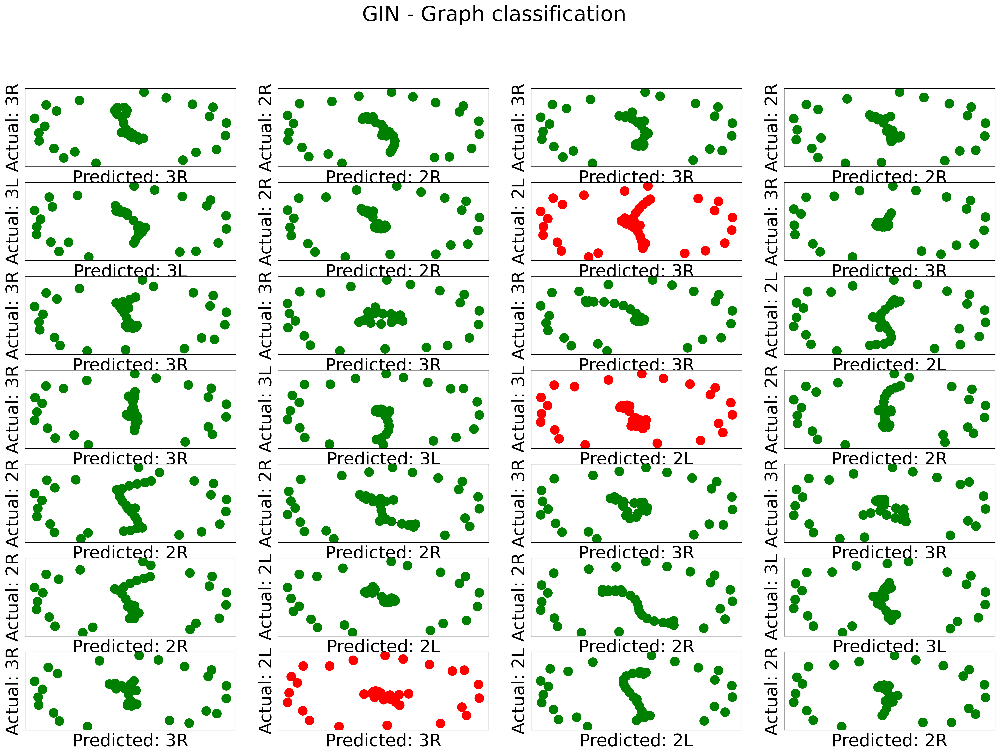

In [ ]:
fig, ax = plt.subplots(7, 4, figsize=(24,16))
fig.suptitle('GIN - Graph classification')
lookup = {0: "2L", 1: "2R", 2: "3L", 3: "3R"}

for i, data in enumerate(dataset[len(dataset) - 28:len(dataset)]):
    # Calculate color (green if correct, red otherwise)
    _, out = gin(data.x, data.edge_index, data.batch)
    #color = "green" # set default color to green
    #if (out.argmax(dim = 1) != data.y):
    # 2L = 0; 2R = 1; 3L = 2, 3R = 3

    color = "green" if out.argmax(dim=1) == data.y else "red"

    # Plot graph
    ix = np.unravel_index(i, ax.shape)
    predicted = out.argmax(dim = 1).numpy()[0]
    actual = data.y.numpy()[0]
    ax[ix].axis('on')
    ax[ix].set_xlabel("Predicted: " + lookup[predicted])
    ax[ix].set_ylabel("Actual: " + lookup[actual])
    G = to_networkx(dataset[i], to_undirected=True)
    nx.draw_networkx(G,
                    pos=nx.spring_layout(G, seed=0),
                    with_labels=False,
                    node_size=150,
                    node_color=color,
                    width=0.8,
                    ax=ax[ix]
                    )

In [ ]:
#gcn.eval()
gin.eval()
acc_gcn = 0
acc_gin = 0
acc = 0

for data in test_loader:
    # Get classifications
    #_, out_gcn = gcn(data.x, data.edge_index, data.batch)
    _, out_gin = gin(data.x, data.edge_index, data.batch)
    out = out_gin

    # Calculate accuracy scores
    #acc_gcn += accuracy(out_gcn.argmax(dim=1), data.y) / len(test_loader)
    acc_gin += accuracy(out_gin.argmax(dim=1), data.y) / len(test_loader)
    acc += accuracy(out.argmax(dim=1), data.y) / len(test_loader)

# Print results
#print(f'GCN accuracy:     {acc_gcn*100:.2f}%')
print(f'GIN accuracy:     {acc_gin*100:.2f}%')
#print(f'GCN+GIN accuracy: {acc*100:.2f}%')

#placeholder = np.array([threshold_val, acc_gin])
#print(placeholder)
#accuracy_collector.append(placeholder)

GIN accuracy:     76.02%


In [ ]:
print(accuracy_collector)


[array([5.0000000e+03, 5.1868427e-01]), array([1.00000000e+04, 5.04120617e-01]), array([2.00000000e+04, 5.37235605e-01]), array([3.000000e+04, 5.447938e-01]), array([3.50000000e+04, 5.69540511e-01]), array([4.00000000e+04, 6.12499997e-01]), array([5.00000000e+04, 5.88815793e-01]), array([5.50000000e+04, 6.11223121e-01]), array([6.00e+04, 6.25e-01]), array([6.50000000e+04, 6.57118052e-01]), array([7.00000000e+04, 6.77966118e-01]), array([9.00000000e+04, 8.23529422e-01])]


In [ ]:
print(len(accuracy_collector))

12


The following are placeholder logics

In [ ]:
# [array([5.0000000e+03, 5.1868427e-01]), array([1.00000000e+04, 5.04120617e-01]), array([2.00000000e+04, 5.37235605e-01]), array([3.000000e+04, 5.447938e-01]), array([3.50000000e+04, 5.69540511e-01]), array([4.00000000e+04, 6.12499997e-01]), array([5.00000000e+04, 5.88815793e-01]), array([5.50000000e+04, 6.11223121e-01]), array([6.00e+04, 6.25e-01]), array([6.50000000e+04, 6.57118052e-01]), array([7.00000000e+04, 6.77966118e-01]), array([9.00000000e+04, 8.23529422e-01])]


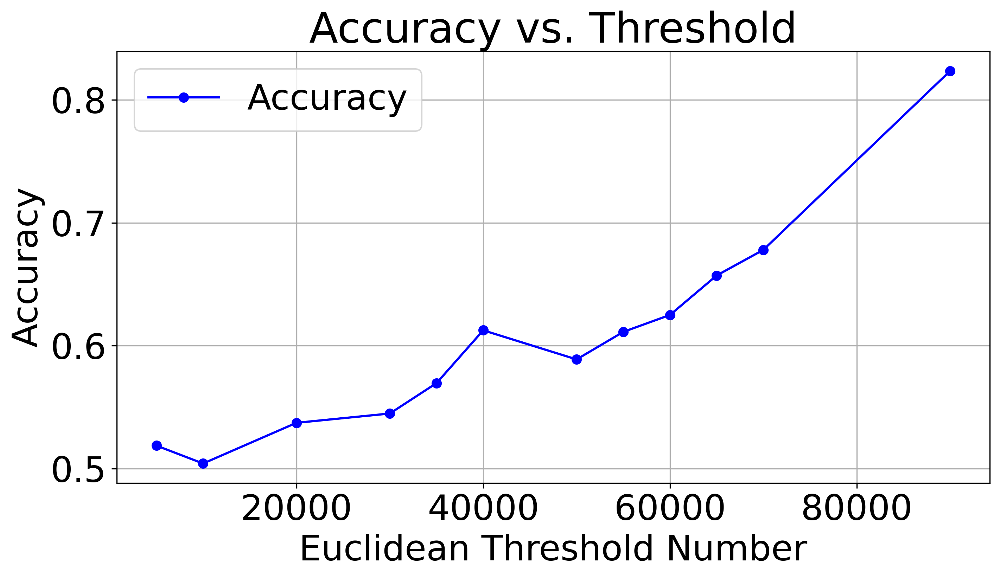

In [ ]:
x_data = [entry[0] for entry in accuracy_collector]
y_data = [entry[1] for entry in accuracy_collector]

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(x_data, y_data, marker='o', linestyle='-', color='b', label='Accuracy')
plt.xlabel('Euclidean Threshold Number')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Threshold')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
#placeholder logics

import torch
from torch_geometric.data import Data, InMemoryDataset
from torch_geometric.utils import from_scipy_sparse_matrix
import scipy.sparse as sp
import numpy as np

class MyCustomDataset(InMemoryDataset):
    def __init__(self, data_list, transform=None, pre_transform=None):
        self.data_list = data_list
        super(MyCustomDataset, self).__init__(None, transform, pre_transform)
        self.data, self.slices = self.collate(data_list)

    @property
    def raw_file_names(self):
        return []

    @property
    def processed_file_names(self):
        return []

    def download(self):
        pass

    def process(self):
        pass

    def len(self):
        return len(self.data_list)

    def get(self, idx):
        return self.data_list[idx]


dataset = []
y = torch.ones_like(placeholder_dataset[0].y.long())

for graph in adjacency_matrix:
    sample = graph.reshape(21, 21)
    node_indices = torch.arange(sample.shape[0], dtype=torch.float).view(-1, 1)
    x = node_indices
    adj_matrix = sp.coo_matrix(sample)
    edge_index, edge_attr = from_scipy_sparse_matrix(adj_matrix)
    data = Data(x=x, edge_index=edge_index, y=torch.tensor(y, dtype=torch.float))
    dataset.append(data)

dataset = MyCustomDataset(dataset)

# Example: Accessing the first graph in the custom dataset
print(dataset[0])
print("Node feature matrix (x):")
print(dataset[0].x)
print("Edge index:")
print(dataset[0].edge_index)
print("Labels (y):")
print(dataset[0].y)
print(len(dataset))

In [ ]:
import torch
from torch_geometric.data import Data
from torch_geometric.utils import from_scipy_sparse_matrix
import scipy.sparse as sp
from torch_geometric.datasets import TUDataset
# ex) x = [2,1000]
dataset = [] #should not use numpy list
y = np.ones((4,))
for graph in adjacency_matrix:
  sample = graph.reshape(21,21)
  node_indices = torch.arange(sample.shape[0], dtype = torch.float)
  x = torch.cat([node_indices])
  adj_matrix = sp.coo_matrix(sample)
  edge_index, edge_attr = from_scipy_sparse_matrix(adj_matrix)
  data = Data(x = x, edge_index = edge_index,y=y)
  dataset.append(data)
#this is a testing unit